<a href="https://colab.research.google.com/github/musaers/Real-Estate-Price-Prediction/blob/main/Real_estate_price_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Veri tipleri:
No                                   int64
Property_Type                       object
Land_Area                            int64
Floor_Area                           int64
Condition                           object
View                                object
Amenities                           object
Furnishing_Status                   object
Air_Conditioning (Yes/No)           object
Heating (Yes/No)                    object
Kitchen_Type                        object
Balcony (Yes/No)                    object
Maintenance_Fees                     int64
Latitude                           float64
Longitude                          float64
Location                            object
Num_bathrooms                        int64
Num_rooms                            int64
Price                                int64
distance to nearest MRT Station    float64
distance to nearest Hospital       float64
distance to nearest School         float64
distance to nearest Bus Stand      float

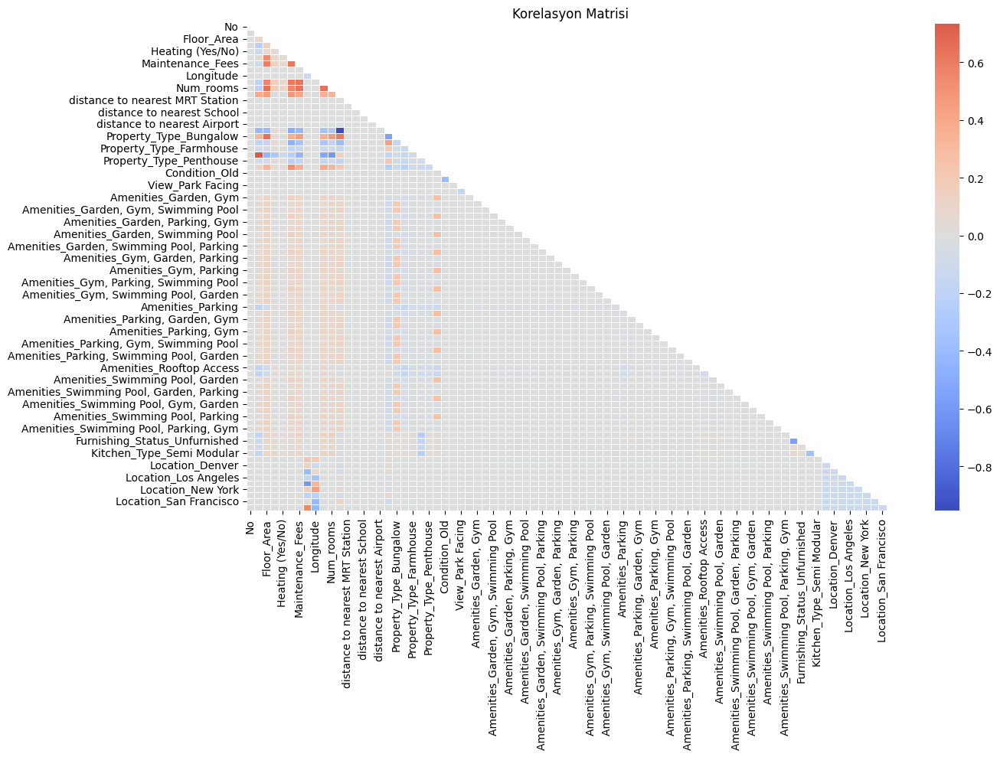


Fiyat ile Korelasyonlar:
Price                      1.000000
Property_Type_Bungalow     0.620299
Balcony (Yes/No)           0.478342
Floor_Area                 0.449184
Maintenance_Fees           0.422642
                             ...   
Location_Phoenix          -0.077777
Property_Type_Farmhouse   -0.166836
Property_Type_Penthouse   -0.199850
Property_Type_Condo       -0.399442
Crimerate in area         -0.954579
Name: Price, Length: 80, dtype: float64

Fiyatla En Yüksek Korelasyonlu 10 Özellik:
['Property_Type_Bungalow', 'Balcony (Yes/No)', 'Floor_Area', 'Maintenance_Fees', 'Land_Area', 'Num_bathrooms', 'Num_rooms', 'Property_Type_Villa', 'Property_Type_Land', 'Amenities_Parking, Gym, Garden']

Modelde Kullanılacak 5 Özellik:
['Property_Type_Bungalow', 'Balcony (Yes/No)', 'Floor_Area', 'Maintenance_Fees', 'Land_Area']

Modelde kullanılacak özellikler:
['Land_Area', 'Floor_Area', 'Num_rooms', 'Num_bathrooms', 'Crimerate in area']

Model Değerlendirme Metrikleri:
MSE: 647215282505.

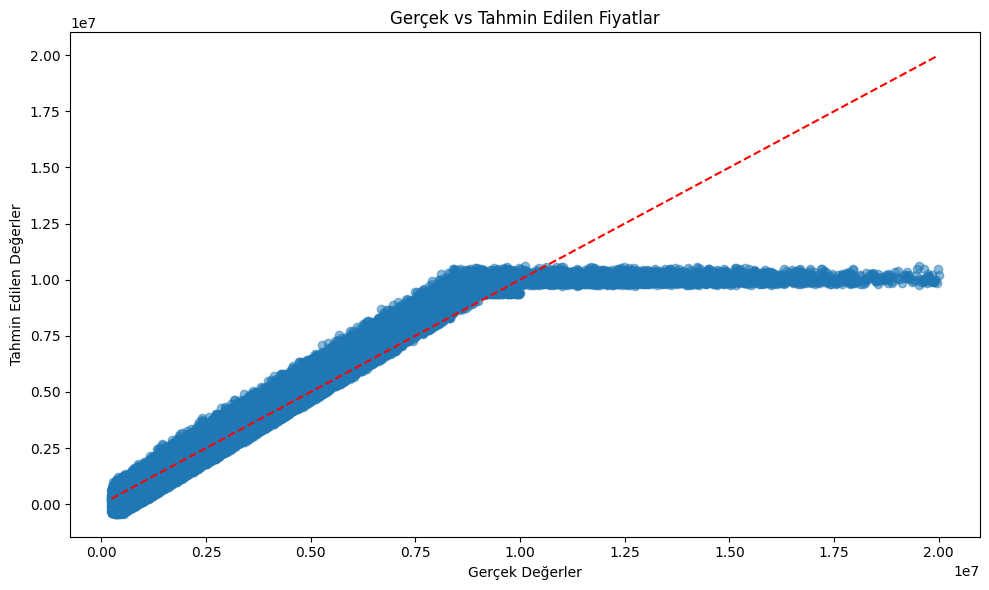

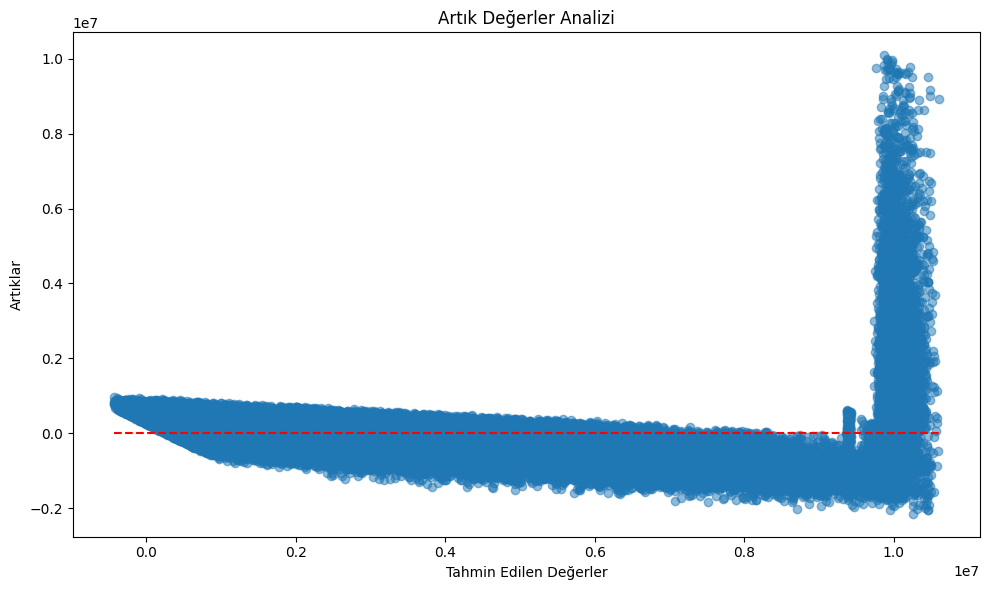

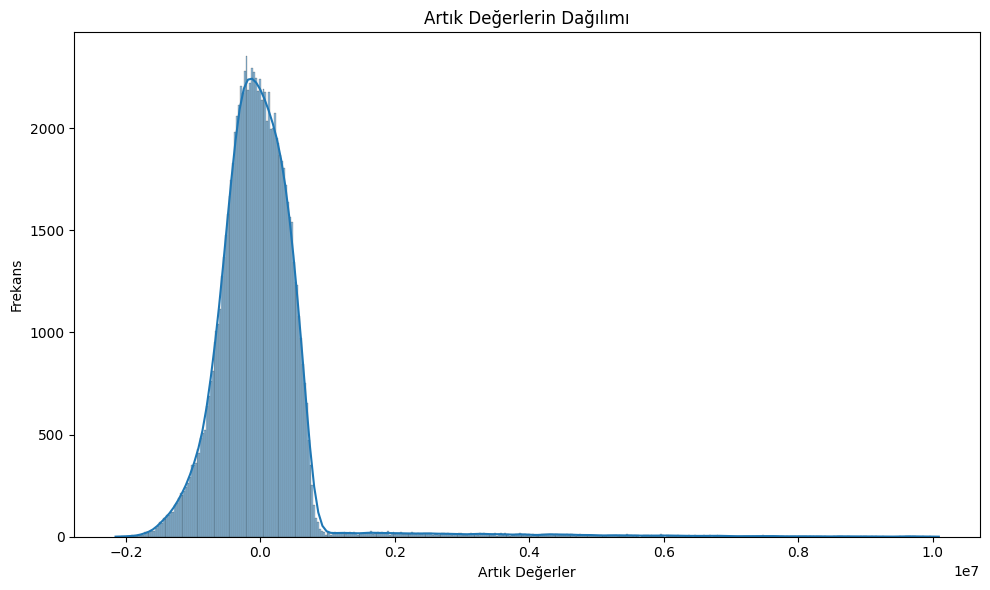

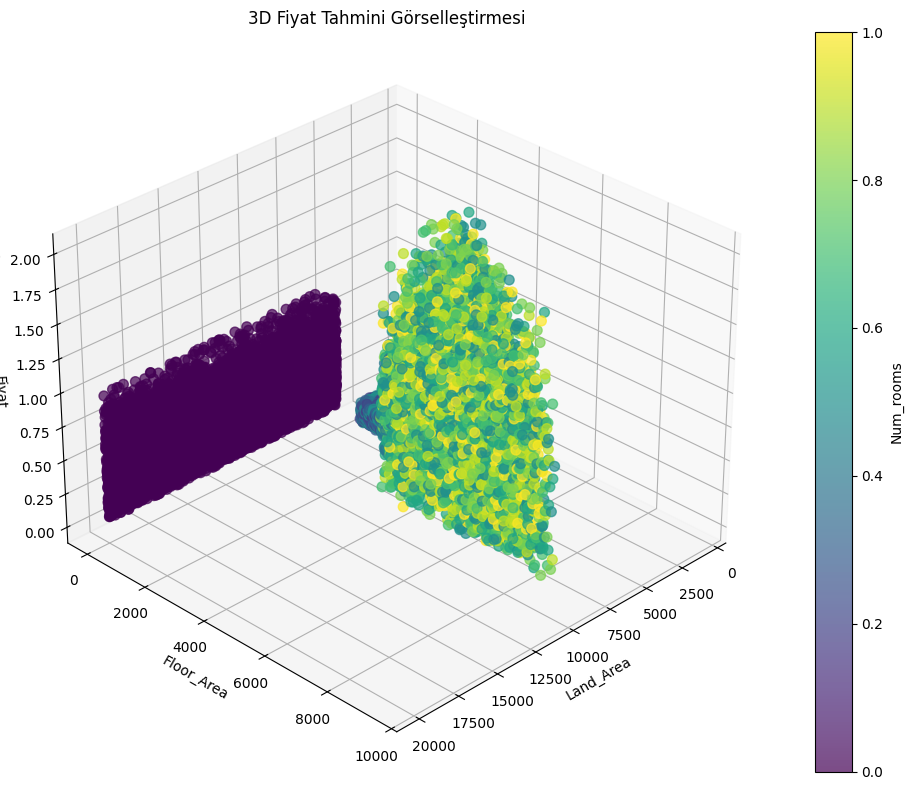

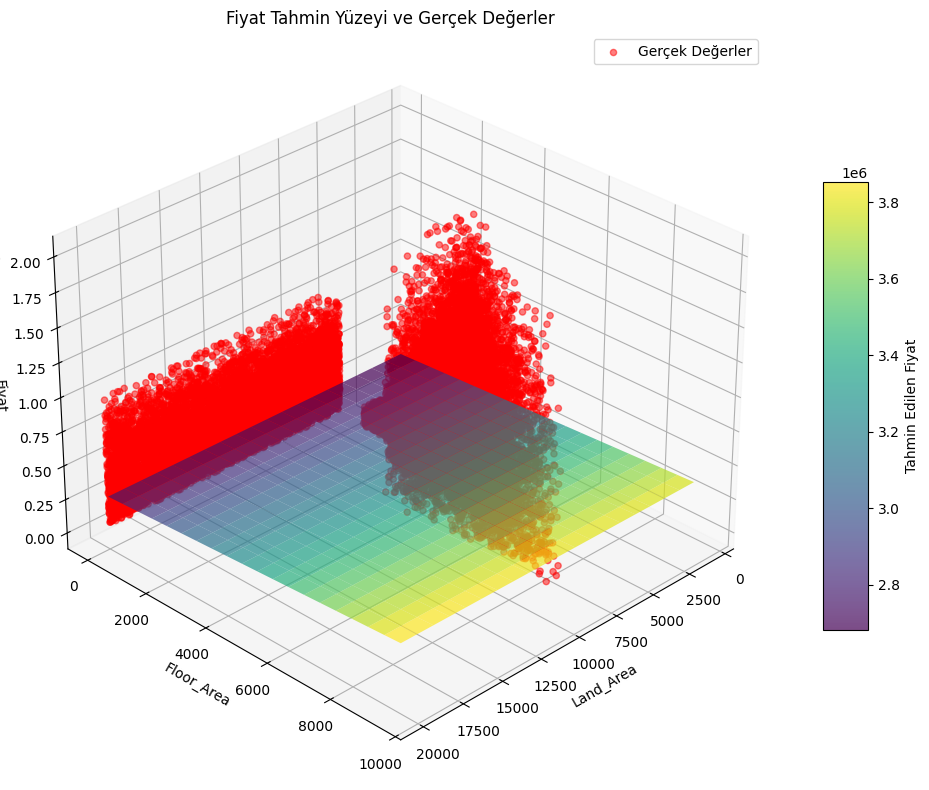

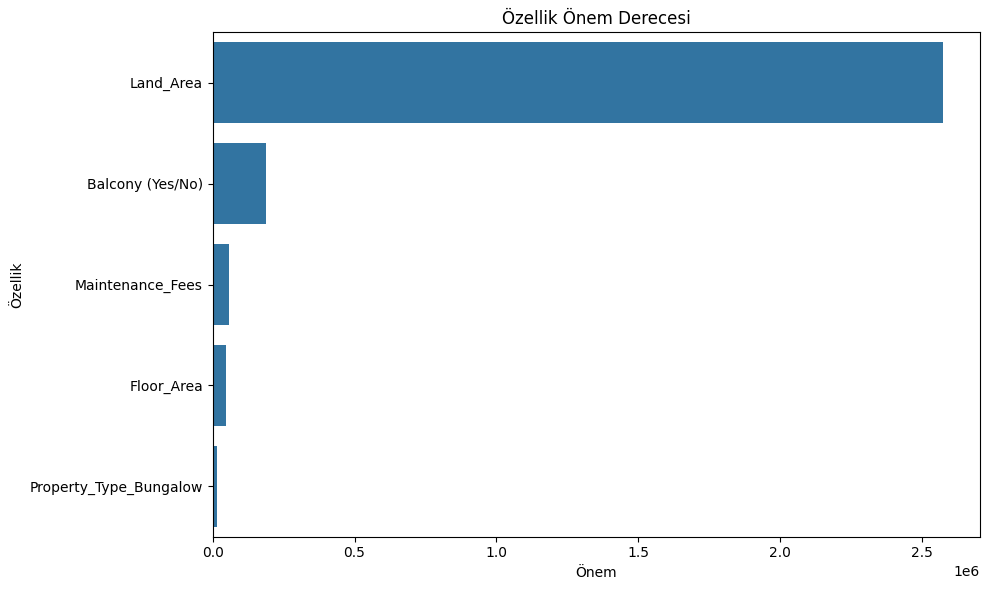


Tüm Değişkenlerle Model R² Skoru: 0.9257456555111836

Örnek Ev için Tahmin Edilen Fiyat: 6,822,776.53 TL

Örnek Ev Özellikleri:
- Land_Area: 450
- Floor_Area: 180
- Num_rooms: 4
- Num_bathrooms: 2
- Crimerate in area: 3.5

Fiyata En Çok Etki Eden Faktörler:
- Floor_Area: 108.4% etki (180.0 × 187628.0797)
- Land_Area: 20.2% etki (450.0 × 14014.0726)
- Num_rooms: 0.6% etki (4.0 × 48283.0410)
- Num_bathrooms: -0.4% etki (2.0 × -56770.5051)
- Crimerate in area: -28.9% etki (3.5 × -2575759.3158)


In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D

# 1. Veri Seti Yükleme
df = pd.read_csv('Dataset.csv')  # Dosya yolunu kendi dosya yolunuzla değiştirin

# 2. Veri Ön İşleme
# Veri tipleri kontrolü
print("Veri tipleri:")
print(df.dtypes)

# Eksik değerleri kontrol et
print("\nEksik değerler:")
print(df.isnull().sum())

# Kategorik değişkenleri belirle
categorical_columns = df.select_dtypes(include=['object']).columns.tolist()
print("\nKategorik sütunlar:", categorical_columns)

# Yes/No değerlerini dönüştürme (varsa)
yes_no_columns = [col for col in categorical_columns if 'Yes' in df[col].values or 'No' in df[col].values]
for col in yes_no_columns:
    df[col] = df[col].map({'Yes': 1, 'No': 0})
    # Eğer dönüşüm başarısız olursa
    if df[col].dtype == 'object':
        print(f"'{col}' sütununda Yes/No dışında değerler olabilir. Benzersiz değerler:", df[col].unique())

# Diğer kategorik değişkenleri one-hot encoding ile dönüştür
categorical_cols_remaining = [col for col in categorical_columns if col not in yes_no_columns]
if categorical_cols_remaining:
    print(f"\nOne-hot encoding uygulanacak kategorik sütunlar: {categorical_cols_remaining}")
    df = pd.get_dummies(df, columns=categorical_cols_remaining, drop_first=True)

# Tüm değişkenlerin sayısal olduğundan emin ol
non_numeric_cols = df.select_dtypes(include=['object']).columns.tolist()
if non_numeric_cols:
    print(f"\nDikkat! Hala sayısal olmayan sütunlar var: {non_numeric_cols}")
    print("Bu sütunlardaki benzersiz değerler:")
    for col in non_numeric_cols:
        print(f"{col}: {df[col].unique()}")

    # Kalan kategorik değişkenleri LabelEncoder ile dönüştür
    from sklearn.preprocessing import LabelEncoder
    for col in non_numeric_cols:
        le = LabelEncoder()
        df[col] = le.fit_transform(df[col])
        print(f"{col} sütunu için etiket eşleştirmeleri: {dict(zip(le.classes_, le.transform(le.classes_)))}")

print("\nDönüşüm sonrası veri tipleri:")
print(df.dtypes)

# 3. Veri Keşfi
print("Veri Seti Boyutu:", df.shape)
print("\nVeri İstatistikleri:")
print(df.describe())

# Korelasyon matrisi
plt.figure(figsize=(14, 10))
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
sns.heatmap(corr, mask=mask, annot=False, cmap='coolwarm', center=0, linewidths=0.5)
plt.title('Korelasyon Matrisi')
plt.tight_layout()
plt.savefig('korelasyon_matrisi.png')
plt.show()

# Fiyatla en yüksek korelasyona sahip değişkenleri bulma
price_corr = corr['Price'].sort_values(ascending=False)
print("\nFiyat ile Korelasyonlar:")
print(price_corr)

# 4. Özellik Seçimi - Fiyatla en yüksek korelasyonlu özellikleri bul
# Tüm özellikler artık sayısal olmalı
all_features = df.columns.tolist()
all_features.remove('Price')  # Target değişkeni çıkar

# Korelasyon değerlerine göre en önemli özellikleri seç
# NaN değerleri varsa bunları filtrele
price_corr_valid = price_corr.dropna()
top_features = [col for col in price_corr_valid.index if col in all_features and col != 'Price'][:10]
print("\nFiyatla En Yüksek Korelasyonlu 10 Özellik:")
print(top_features)

# Özellik sayısını isteğe bağlı olarak sınırla (örn. en önemli 5 özellik)
top_features = top_features[:5]
print("\nModelde Kullanılacak 5 Özellik:")
print(top_features)

# 5. Model Veri Hazırlama
# Genellikle emlak verisetlerinde şu özellikler en önemliler arasındadır
model_features = [
    'Land_Area',  # Arsa alanı
    'Floor_Area',  # Konut alanı
    'Num_rooms',  # Oda sayısı
    'Num_bathrooms',  # Banyo sayısı
    'Crimerate in area'  # Bölgedeki suç oranı
]

# Bu özellikler veri setinde mevcut değilse uyarlanabilir
# Mevcut sütunları kontrol et ve gerekirse model_features'ı güncelle
available_features = [col for col in model_features if col in df.columns]
if len(available_features) < len(model_features):
    missing_features = [col for col in model_features if col not in df.columns]
    print(f"\nUyarı: Bazı önerilen özellikler veri setinde mevcut değil: {missing_features}")
    print(f"Mevcut özellikler: {available_features}")

    # Eksik özellikler yerine fiyat ile en yüksek korelasyonlu özellikleri ekle
    additional_features = [col for col in price_corr.index if col in df.columns
                         and col != 'Price'
                         and col not in available_features][:5-len(available_features)]

    if additional_features:
        print(f"Eksik özellikler yerine şu yüksek korelasyonlu özellikler kullanılacak: {additional_features}")
        model_features = available_features + additional_features
    else:
        model_features = available_features

# Eğer yine de yeterli özellik yoksa, one-hot encoded sütunlardan ekle
if len(model_features) < 3:  # En az 3 özellik olsun
    one_hot_cols = [col for col in df.columns if '_' in col and col not in model_features and col != 'Price']
    if one_hot_cols:
        additional_one_hot = one_hot_cols[:5-len(model_features)]
        print(f"Ek olarak şu one-hot encoded özellikler kullanılacak: {additional_one_hot}")
        model_features.extend(additional_one_hot)

print("\nModelde kullanılacak özellikler:")
print(model_features)

X = df[model_features]
y = df['Price']

# Eğitim ve test verisi ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Verileri ölçeklendirme
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 6. Multilinear Regression Modeli
model = LinearRegression()
model.fit(X_train_scaled, y_train)

# 7. Model Değerlendirme
y_pred = model.predict(X_test_scaled)

# Model metrikleri
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("\nModel Değerlendirme Metrikleri:")
print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R² Skoru: {r2:.4f}")

# Katsayıları ve sabiti görüntüleme
print("\nModel Katsayıları:")
for i, feature in enumerate(top_features):
    print(f"{feature}: {model.coef_[i]:.4f}")
print(f"Kesişim (Intercept): {model.intercept_:.4f}")

# 8. Gerçek vs Tahmin Görselleştirmesi
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel('Gerçek Değerler')
plt.ylabel('Tahmin Edilen Değerler')
plt.title('Gerçek vs Tahmin Edilen Fiyatlar')
plt.tight_layout()
plt.savefig('gercek_vs_tahmin.png')
plt.show()

# 9. Artık Değerlerin Analizi
residuals = y_test - y_pred

plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, alpha=0.5)
plt.hlines(y=0, xmin=y_pred.min(), xmax=y_pred.max(), colors='r', linestyles='--')
plt.xlabel('Tahmin Edilen Değerler')
plt.ylabel('Artıklar')
plt.title('Artık Değerler Analizi')
plt.tight_layout()
plt.savefig('artik_degerler.png')
plt.show()

# Artık değerlerin histogramı
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True)
plt.xlabel('Artık Değerler')
plt.ylabel('Frekans')
plt.title('Artık Değerlerin Dağılımı')
plt.tight_layout()
plt.savefig('artik_dagilim.png')
plt.show()

# 10. 3D Görselleştirme (Seçilen 3 önemli değişken ile)
if len(model_features) >= 3:
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # İlk üç önemli değişkeni kullan
    x1 = X_test[model_features[0]]
    x2 = X_test[model_features[1]]

    # Renklendirme için üçüncü değişkeni kullan
    colors = X_test[model_features[2]]

    # Normalizasyon için min-max scaler
    from sklearn.preprocessing import MinMaxScaler
    color_scaler = MinMaxScaler()
    colors_normalized = color_scaler.fit_transform(colors.values.reshape(-1, 1)).flatten()

    # 3D scatter plot
    scatter = ax.scatter(x1, x2, y_test,
                        c=colors_normalized,
                        cmap='viridis',
                        marker='o',
                        alpha=0.7,
                        s=50)

    # Renk çubuğu ekle
    cbar = plt.colorbar(scatter)
    cbar.set_label(model_features[2])

    # Eksen etiketleri
    ax.set_xlabel(model_features[0])
    ax.set_ylabel(model_features[1])
    ax.set_zlabel('Fiyat')
    ax.set_title('3D Fiyat Tahmini Görselleştirmesi')

    # Görünümü ayarla
    ax.view_init(elev=30, azim=45)

    plt.tight_layout()
    plt.savefig('3d_visualization.png')
    plt.show()
else:
    print("3D görselleştirme için en az 3 özellik gereklidir.")

# 3D yüzey grafiği
if len(model_features) >= 2:
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # İlk iki değişkeni kullan
    x1 = X_test[model_features[0]]
    x2 = X_test[model_features[1]]

    # Tahmin yüzeyi için grid oluştur
    x1_min, x1_max = x1.min(), x1.max()
    x2_min, x2_max = x2.min(), x2.max()

    x1_grid = np.linspace(x1_min, x1_max, 20)
    x2_grid = np.linspace(x2_min, x2_max, 20)

    x1_mesh, x2_mesh = np.meshgrid(x1_grid, x2_grid)

    # Grid noktaları için tahmin yapabilmek için DataFrame oluştur
    grid_points = pd.DataFrame({
        model_features[0]: x1_mesh.flatten(),
        model_features[1]: x2_mesh.flatten()
    })

    # Diğer özellikleri ortalama değerleriyle doldur
    for feature in model_features[2:]:
        grid_points[feature] = X_test[feature].mean()

    # Grid noktaları için ölçeklendirme
    grid_points_scaled = scaler.transform(grid_points)

    # Tahminleri yap
    z_pred = model.predict(grid_points_scaled).reshape(x1_mesh.shape)

    # Yüzeyi çiz
    surface = ax.plot_surface(x1_mesh, x2_mesh, z_pred, cmap='viridis', alpha=0.7)

    # Gerçek verileri 3D scatter olarak çiz
    ax.scatter(x1, x2, y_test, c='red', marker='o', alpha=0.5, label='Gerçek Değerler')

    # Eksen etiketleri ve başlık
    ax.set_xlabel(model_features[0])
    ax.set_ylabel(model_features[1])
    ax.set_zlabel('Fiyat')
    ax.set_title('Fiyat Tahmin Yüzeyi ve Gerçek Değerler')

    # Renk çubuğu
    cbar = fig.colorbar(surface, ax=ax, shrink=0.6, aspect=10)
    cbar.set_label('Tahmin Edilen Fiyat')

    # Görünümü ayarla
    ax.view_init(elev=30, azim=45)

    plt.legend()
    plt.tight_layout()
    plt.savefig('3d_surface.png')
    plt.show()

# 11. Plotly ile İnteraktif Görselleştirmeler
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Gerçek vs Tahmin Scatter Plot
fig = px.scatter(
    x=y_test,
    y=y_pred,
    labels={'x': 'Gerçek Değerler', 'y': 'Tahmin Edilen Değerler'},
    title='Gerçek vs Tahmin Edilen Fiyatlar'
)

# Mükemmel tahmin çizgisi
fig.add_trace(
    go.Scatter(
        x=[y_test.min(), y_test.max()],
        y=[y_test.min(), y_test.max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Mükemmel Tahmin'
    )
)

fig.update_layout(
    width=800,
    height=600,
    template='plotly_white'
)

fig.write_html('gercek_vs_tahmin_interaktif.html')
fig.show()

# Artık Değerler Grafiği
fig = px.scatter(
    x=y_pred,
    y=residuals,
    labels={'x': 'Tahmin Edilen Değerler', 'y': 'Artık Değerler'},
    title='Artık Değerler Analizi'
)

fig.add_hline(
    y=0,
    line_dash='dash',
    line_color='red',
    annotation_text='Sıfır Çizgisi',
    annotation_position='bottom right'
)

fig.update_layout(
    width=800,
    height=600,
    template='plotly_white'
)

fig.write_html('artik_degerler_interaktif.html')
fig.show()

# Özellik Önem Derecesi
importance_df = pd.DataFrame({
    'Özellik': model_features,
    'Önem': np.abs(model.coef_)
})
importance_df = importance_df.sort_values('Önem', ascending=False)

fig = px.bar(
    importance_df,
    x='Önem',
    y='Özellik',
    orientation='h',
    title='Özellik Önem Derecesi'
)

fig.update_layout(
    width=800,
    height=500,
    template='plotly_white',
    yaxis={'categoryorder': 'total ascending'}
)

fig.write_html('ozellik_onem_interaktif.html')
fig.show()

# 3B İnteraktif Görselleştirme (eğer yeterli özellik varsa)
if len(model_features) >= 3:
    fig = px.scatter_3d(
        x=X_test[model_features[0]],
        y=X_test[model_features[1]],
        z=y_test,
        color=X_test[model_features[2]],
        labels={
            'x': model_features[0],
            'y': model_features[1],
            'z': 'Fiyat',
            'color': model_features[2]
        },
        title='3B İnteraktif Fiyat Analizi'
    )

    fig.update_layout(
        width=900,
        height=700,
        scene=dict(
            xaxis_title=model_features[0],
            yaxis_title=model_features[1],
            zaxis_title='Fiyat'
        )
    )

    fig.write_html('3b_interaktif.html')
    fig.show()

# Dağılım Matrisi - Her özelliğin fiyat ile ilişkisi
fig = px.scatter_matrix(
    df[model_features + ['Price']],
    dimensions=model_features + ['Price'],
    color='Price',
    title='Özellikler Arası İlişki Matrisi'
)

fig.update_layout(
    width=1000,
    height=900,
    template='plotly_white'
)

fig.write_html('dagilim_matrisi.html')
fig.show()

# Dashboard oluşturma - Tüm grafikleri tek sayfada toplama
fig = make_subplots(
    rows=2,
    cols=2,
    subplot_titles=(
        'Gerçek vs Tahmin Edilen Fiyatlar',
        'Artık Değerler Analizi',
        'Özellik Önem Derecesi',
        'Artık Değerlerin Dağılımı'
    ),
    specs=[
        [{"type": "scatter"}, {"type": "scatter"}],
        [{"type": "bar"}, {"type": "histogram"}]
    ]
)

# Gerçek vs Tahmin
fig.add_trace(
    go.Scatter(
        x=y_test,
        y=y_pred,
        mode='markers',
        marker=dict(color='blue', opacity=0.6),
        name='Tahminler'
    ),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(
        x=[y_test.min(), y_test.max()],
        y=[y_test.min(), y_test.max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Mükemmel Tahmin'
    ),
    row=1, col=1
)

# Artık Değerler
fig.add_trace(
    go.Scatter(
        x=y_pred,
        y=residuals,
        mode='markers',
        marker=dict(color='green', opacity=0.6),
        name='Artık Değerler'
    ),
    row=1, col=2
)

fig.add_trace(
    go.Scatter(
        x=[y_pred.min(), y_pred.max()],
        y=[0, 0],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='Sıfır Çizgisi',
        showlegend=False
    ),
    row=1, col=2
)

# Özellik Önem Derecesi
for i, (feature, importance) in enumerate(zip(importance_df['Özellik'], importance_df['Önem'])):
    fig.add_trace(
        go.Bar(
            x=[importance],
            y=[feature],
            orientation='h',
            name=feature,
            showlegend=False
        ),
        row=2, col=1
    )

# Artık Değerlerin Histogramı
fig.add_trace(
    go.Histogram(
        x=residuals,
        marker=dict(color='purple', opacity=0.7),
        name='Artık Dağılımı',
        showlegend=False
    ),
    row=2, col=2
)

fig.update_layout(
    height=900,
    width=1200,
    title_text="Fiyat Tahmin Modeli Dashboard",
    template='plotly_white'
)

fig.write_html('dashboard.html')
fig.show()

# 12. Özellik Önem Derecesi Görselleştirmesi
importance_df = pd.DataFrame({
    'Özellik': top_features,
    'Önem': np.abs(model.coef_)
})
importance_df = importance_df.sort_values('Önem', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Önem', y='Özellik', data=importance_df)
plt.title('Özellik Önem Derecesi')
plt.tight_layout()
plt.savefig('ozellik_onem.png')
plt.show()

# 13. Eğer isterseniz, tüm değişkenleri kullanarak tam model
X_full = df.drop('Price', axis=1)
y = df['Price']

X_train_full, X_test_full, y_train_full, y_test_full = train_test_split(X_full, y, test_size=0.2, random_state=42)

scaler_full = StandardScaler()
X_train_full_scaled = scaler_full.fit_transform(X_train_full)
X_test_full_scaled = scaler_full.transform(X_test_full)

model_full = LinearRegression()
model_full.fit(X_train_full_scaled, y_train_full)

y_pred_full = model_full.predict(X_test_full_scaled)
r2_full = r2_score(y_test_full, y_pred_full)

print("\nTüm Değişkenlerle Model R² Skoru:", r2_full)

# 14. Yeni bir ev için tahmin yapma örneği
# Örnek: Yeni ev veri noktası
sample_home = pd.DataFrame({
    'Land_Area': [450],                   # 450 m² arsa alanı
    'Floor_Area': [180],                  # 180 m² konut alanı
    'Num_rooms': [4],                     # 4 oda
    'Num_bathrooms': [2],                 # 2 banyo
    'Crimerate in area': [3.5],           # 3.5/10 suç oranı (düşük-orta)
    'Property_Type_House': [1],           # Ev tipi: House (1), diğerleri 0
    'Property_Type_Apartment': [0],
    'Property_Type_Condo': [0],
    'Condition_Good': [1],                # Durum: İyi (1), diğerleri 0
    'Condition_Poor': [0],
    'Furnishing_Status_Furnished': [1],   # Mobilyalı (1)
    'Location_City Center': [0],
    'Location_Suburban': [1],             # Konum: Şehir dışı (1), diğerleri 0
    'Heating (Yes/No)': [1],              # Isıtma var (1)
    'Air_Conditioning (Yes/No)': [1]      # Klima var (1)
})

# Modelde kullanılan özellikleri seç
sample_features = {}
for feature in model_features:
    if feature in sample_home.columns:
        sample_features[feature] = sample_home[feature].values[0]
    else:
        print(f"Uyarı: '{feature}' özelliği örnek evde tanımlanmamış. Ortalama değer kullanılacak.")
        # Eksik özellikleri veri setinin ortalaması ile doldur
        sample_features[feature] = X[feature].mean()

# Örnek evi yeniden oluştur
sample_home_filtered = pd.DataFrame([sample_features])

# Örnek evi ölçeklendirme
sample_home_scaled = scaler.transform(sample_home_filtered)

# Fiyat tahmini
predicted_price = model.predict(sample_home_scaled)[0]
print(f"\nÖrnek Ev için Tahmin Edilen Fiyat: {predicted_price:,.2f} TL")

# Örnek evin özelliklerini ve tahmini yazdır
print("\nÖrnek Ev Özellikleri:")
for feature, value in sample_features.items():
    print(f"- {feature}: {value}")

# Fiyata etki eden faktörler
impact = pd.DataFrame({
    'Özellik': model_features,
    'Değer': [sample_features[f] for f in model_features],
    'Katsayı': model.coef_,
    'Etki': [sample_features[f] * coef for f, coef in zip(model_features, model.coef_)]
})
impact = impact.sort_values('Etki', ascending=False)

print("\nFiyata En Çok Etki Eden Faktörler:")
for i, row in impact.iterrows():
    pct = (row['Etki'] / impact['Etki'].sum()) * 100
    print(f"- {row['Özellik']}: {pct:.1f}% etki ({row['Değer']} × {row['Katsayı']:.4f})")